In [154]:
from transformers import pipeline
from PIL import Image
import requests
import os
import tqdm
import cv2

In [155]:
checkpoint = "openai/clip-vit-large-patch14"
detector = pipeline(model=checkpoint, task="zero-shot-image-classification")

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


In [156]:
image_folder = '/Users/essajan/Desktop/DL/final_dataset/Annotated_data/test/empty'
empty_directory = os.listdir(image_folder)
empty = []
for each in empty_directory:
    if each == ".DS_Store":
        pass
    else:
        empty.append(Image.open(f"{image_folder}/{each}"))

print("No of Empty Images : " , len(empty))

No of Empty Images :  120


In [157]:
image_folder = '/Users/essajan/Desktop/DL/final_dataset/Annotated_data/test/Smoke'
Smoke_directory = os.listdir(image_folder)
smoke = []
for each in Smoke_directory:
    if each == ".DS_Store":
        pass
    else:
        smoke.append(Image.open(f"{image_folder}/{each}"))

print("No of Smoke Images : " , len(smoke))


No of Smoke Images :  71


In [158]:
image_folder = '/Users/essajan/Desktop/DL/final_dataset/Annotated_data/test/Fire'
fire_directory = os.listdir(image_folder)
fire = []
for each in fire_directory:
    if each == ".DS_Store":
        pass
    else:
        fire.append(Image.open(f"{image_folder}/{each}"))

image_folder = '/Users/essajan/Desktop/DL/final_dataset/Annotated_data/test/Fire_multiple'
for each in fire_directory:
    if each == ".DS_Store":
        pass
    else:
        try:
            fire.append(Image.open(f"{image_folder}/{each}"))
        except:
            pass
print("No of Fire Images : " , len(fire))

No of Fire Images :  23


In [159]:
image_folder = '/Users/essajan/Desktop/DL/final_dataset/Annotated_data/test/Hazy'
Hazy_directory = os.listdir(image_folder)
hazy = []
for each in Hazy_directory:
    if each == ".DS_Store":
        pass
    else:
        hazy.append(Image.open(f"{image_folder}/{each}"))

print("No of hazy Images : " , len(hazy))

No of hazy Images :  150


In [160]:
# Empty 
fire_results = []
fire_smoke_results = []
haze_results = []

for i in tqdm.tqdm(range(len(empty))):
        hazy_prediction = detector(empty[i], candidate_labels=["Hazy Image"  ,"Not Hazy Image"])[0]['label']
        Fire_Smoke_prediction = detector(empty[i], candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        Fireprediction = detector(empty[i], candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        haze_results.append(hazy_prediction)
        fire_smoke_results.append(Fire_Smoke_prediction)
        fire_results.append(Fireprediction)


print("Fire False Postive : " , fire_results.count("Forest Fire")/len(empty))
print("Smoke False Postive: " , fire_smoke_results.count("Smoke/Fire")/len(empty))
print("Haze False Postive : ", haze_results.count("Hazy Image")/len(empty))

100%|██████████| 120/120 [02:24<00:00,  1.21s/it]

Fire False Postive :  0.025
Smoke False Postive:  0.08333333333333333
Haze False Postive :  0.31666666666666665


In [166]:
# Smoke
fire_results = []
fire_smoke_results = []
haze_results = []

for i in tqdm.tqdm(range(len(smoke))):
        hazy_prediction = detector(smoke[i], candidate_labels=["Hazy Image"  ,"Not Hazy Image"])[0]['label']
        Fire_Smoke_prediction = detector(smoke[i], candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        Fireprediction = detector(smoke[i], candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        haze_results.append(hazy_prediction)
        fire_smoke_results.append(Fire_Smoke_prediction)
        fire_results.append(Fireprediction)


print("Fire False Postive : " , fire_results.count("Forest Fire")/len(smoke))
print("Smoke Accuracy : " , fire_smoke_results.count("Smoke/Fire")/len(smoke))
print("Haze False Postive : ", haze_results.count("Hazy Image" )/len(smoke))

100%|██████████| 71/71 [01:33<00:00,  1.32s/it]

Fire False Postive :  0.1267605633802817
Smoke Accuracy :  0.4507042253521127
Haze False Postive :  0.19718309859154928


In [165]:
# Fire
fire_results = []
fire_smoke_results = []
haze_results = []

for i in tqdm.tqdm(range(len(fire))):
        hazy_prediction = detector(fire[i], candidate_labels=["Hazy Image"  ,"Not Hazy Image"])[0]['label']
        Fire_Smoke_prediction = detector(fire[i], candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        Fireprediction = detector(fire[i], candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        haze_results.append(hazy_prediction)
        fire_smoke_results.append(Fire_Smoke_prediction)
        fire_results.append(Fireprediction)


print("Fire Accuracy : " , fire_results.count("Forest Fire" )/len(fire))
print("Smoke False Positive : " , fire_smoke_results.count("Smoke/Fire")/len(fire))
print("Haze False Postive : ", haze_results.count("Hazy Image" )/len(fire))

100%|██████████| 23/23 [00:27<00:00,  1.17s/it]

Fire Accuracy :  0.6956521739130435
Smoke False Positive :  0.8695652173913043
Haze False Postive :  0.9565217391304348


In [163]:
# Haze
fire_results = []
fire_smoke_results = []
haze_results = []

for i in tqdm.tqdm(range(len(hazy))):
        hazy_prediction = detector(hazy[i], candidate_labels=["Hazy Image"  ,"Not Hazy Image"])[0]['label']
        Fire_Smoke_prediction = detector(hazy[i], candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        Fireprediction = detector(hazy[i], candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        haze_results.append(hazy_prediction)
        fire_smoke_results.append(Fire_Smoke_prediction)
        fire_results.append(Fireprediction)


print("Fire Fasle Postive: " , fire_results.count("Forest Fire" )/len(hazy))
print("Smoke False Positive : " , fire_smoke_results.count("Smoke/Fire")/len(hazy))
print("Haze Accuracy: ", haze_results.count("Hazy Image" )/len(hazy))

100%|██████████| 150/150 [02:53<00:00,  1.16s/it]

Fire Fasle Postive:  0.0
Smoke False Positive :  0.013333333333333334
Haze Accuracy:  0.96




---
**IMPLEMENTING CHANGES FOR FURTHER IMPROVEMENTS**


---
Here we try 2 methods in attempt to improve the results:


1.   Apply a day/night filter
      *   we noticed that fire cases were only present at night where we can't see smoke or haze
      *   we also saw that during day, fires weren't visible; we only saw smoke and haze
      * therefore, we proposed filtering images based on whether they are day or night before running the model
      * based on time of day, we use a different prompt. For night we only ask CLIP to detect fire or empty images. For day it should detect smoke, haze or empty
      * this is to limit the models focus and prevent misclassificcation as in fire case we had high false positives for Haze and Fire. We believe this would improve performance.


2.   Divide images to 9 sections (3x3) grid
      * LLaVA and CLIP do not provide bounding boxes or provide location information for objects classified (at least not precise info)
      * to overcome this, we propose to divide the image into several sections and run the model on each individual section to see if we can classify and find location of smoke/fire
      * we understand this is a computationally expensive method however it does limit the model's focus on certain sections and therefore provides 2 benefits. Firstly the limited focus could lead to better performance in detecting fire/smoke. Secondly, it could provide some location information as to where the fire/smoke is in an image

Based on performance/results we could try to use these 2 methods together to improve the overall model's peformance


**Detecting Day/Night using Pixel Intensity**

In [107]:
def is_night(img, threshold=101):
    img_gray = img.convert("L")  # Convert image to grayscale
    img_data = list(img_gray.getdata())  # Get pixel data
    pix_mean = sum(img_data) / len(img_data)  # Calculate mean intensity
    if pix_mean < threshold:
        return True  # Night
    else:
        return False  # Day

In [108]:
#on fire_pics (all night images)

night = 0
day = 0
for img in fire:
  if is_night(img, 101):
    night += 1
  else:
    day += 1

print("---RESULTS---")
print("correct night prediction:", night)
print("wrong day prediction:", day)
print("Night Accuracy : " , night/len(fire))

---RESULTS---
correct night prediction: 20
wrong day prediction: 3
Night Accuracy :  0.8695652173913043


In [109]:
night = 0
day = 0
for img in smoke:
  if is_night(img, 101):
    night += 1
  else:
    day += 1

print("---RESULTS---")
print("correct day prediction:", day)
print("wrong night prediction:", night)
print("Day Accuracy : " , day/len(smoke))

---RESULTS---
correct day prediction: 70
wrong night prediction: 1
Day Accuracy :  0.9859154929577465


**Detecting Day/Night using ClIP**

In [114]:
# Detecting Night 
Night_results = []

for i in tqdm.tqdm(range(len(fire))):
        night_prediction = detector(fire[i], candidate_labels=["Day"  ,"Night"])[0]['label']
        Night_results.append(night_prediction)
    


print("Night Accuracy : " , Night_results.count("Night" )/len(fire))

100%|██████████| 23/23 [00:09<00:00,  2.38it/s]

Night Accuracy :  1.0


In [115]:
# Detecting Day
Day_results = []

for i in tqdm.tqdm(range(len(smoke))):
        day_prediction = detector(smoke[i], candidate_labels=["Day"  ,"Night"])[0]['label']
        Day_results.append(day_prediction)
    


print("Night Accuracy : " , Day_results.count("Day" )/len(smoke))

100%|██████████| 71/71 [00:29<00:00,  2.44it/s]

Night Accuracy :  1.0


**Applying Smoke Filter for Day**


This will not improve the results as the model accuracy for day and night is 100% and all our smoke images are day images and night images are fire images but it create a deployment pipeline for realtime data to avoid any false positves 

In [116]:
# Applying Night and Fire Filter
Night_results = []
fire_results = [] 
for i in tqdm.tqdm(range(len(fire))):
        night_prediction = detector(fire[i], candidate_labels=["Day"  ,"Night"])[0]['label']
        Night_results.append(night_prediction)
        if(night_prediction == "Night"):
                Fireprediction = detector(fire[i], candidate_labels=["Fire"  ,"No Fire"])[0]['label']
                fire_results.append(Fireprediction)
    


print("Night Accuracy : " , Night_results.count("Night" )/len(Night_results))
print("Fire Accuracy: " , fire_results.count("Fire")/len(fire_results))

100%|██████████| 23/23 [00:17<00:00,  1.33it/s]

Night Accuracy :  1.0
Fire Accuracy:  0.30434782608695654


In [117]:
# Applying Day and Smoke Filter
Night_results = []
Smoke_results = [] 
haze_results = []
for i in tqdm.tqdm(range(len(smoke))):
        night_prediction = detector(smoke[i], candidate_labels=["Day"  ,"Night"])[0]['label']
        Night_results.append(night_prediction)
        if(night_prediction == "Day"):
                Smoke_prediction = detector(smoke[i], candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
                hazy_prediction = detector(hazy[i], candidate_labels=["Hazy Image"  ,"Not Hazy Image"])[0]['label']
                Smoke_results.append(Smoke_prediction)
                haze_results.append(hazy_prediction)
    


print("Night Accuracy : " , Night_results.count("Day" )/len(Night_results))
print("Smoke Accuracy: " , Smoke_results.count("Smoke/Fire")/len(Smoke_results))
print("Haze False Postive : ", haze_results.count("Hazy Image" )/len(haze_results))


100%|██████████| 71/71 [01:27<00:00,  1.23s/it]

Night Accuracy :  1.0
Smoke Accuracy:  0.4507042253521127
Haze False Postive :  0.971830985915493


In [118]:
def divide_image(image):
    width, height = image.size
    subimage_width = width // 3
    subimage_height = height // 3
    subimages = []
    for y in range(3):
        for x in range(3):
            left = x * subimage_width
            upper = y * subimage_height
            right = left + subimage_width
            lower = upper + subimage_height
            subimage = image.crop((left, upper, right, lower))
            subimages.append(subimage)
    return subimages

Original Image: 


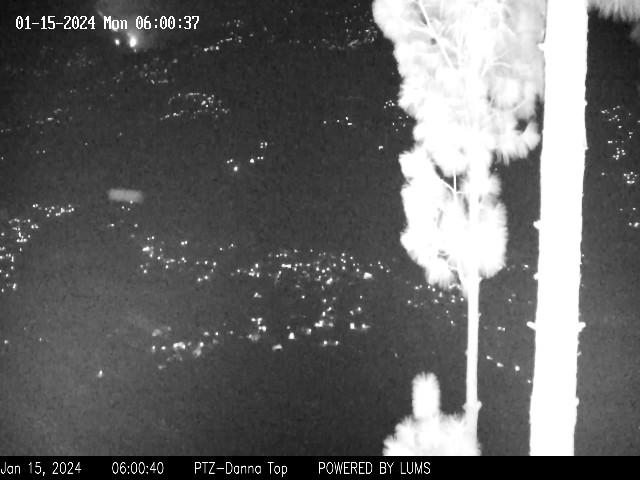

Fire prediction for Night Image :  Forest Fire


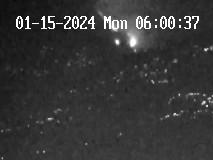

Fire prediction for Night Image :  Forest Fire


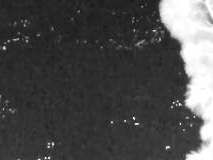

Fire prediction for Night Image :  Forest Fire


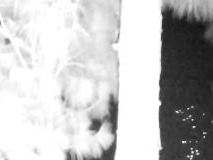

Fire prediction for Night Image :  No Forest Fire


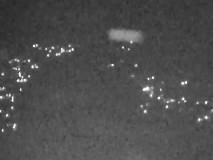

Fire prediction for Night Image :  No Forest Fire


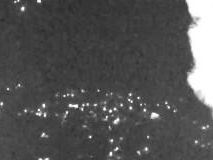

Fire prediction for Night Image :  No Forest Fire


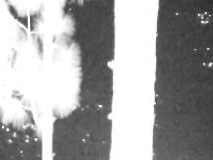

Fire prediction for Night Image :  No Forest Fire


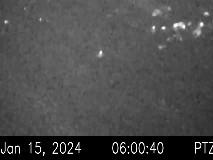

Fire prediction for Night Image :  No Forest Fire


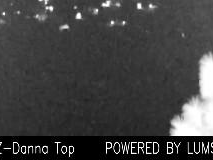

Fire prediction for Night Image :  No Forest Fire


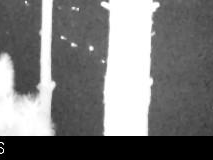

Fire prediction for Night Image :  No Forest Fire


In [148]:
#fire
subimages = divide_image(fire[7])
image = fire[7]
print("Original Image: ")
display(image)
night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
if(night_prediction == "Day"):
        Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        print("Smoke prediction for day Image: " , Smoke_prediction)
else:
        Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        print("Fire prediction for Night Image : " , Fireprediction)

for image in subimages:
        display(image)
        night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
        if(night_prediction == "Day"):
                Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
                print("Smoke prediction for day Image: " , Smoke_prediction)
        else:
                Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
                print("Fire prediction for Night Image : " , Fireprediction)


Original Image: 


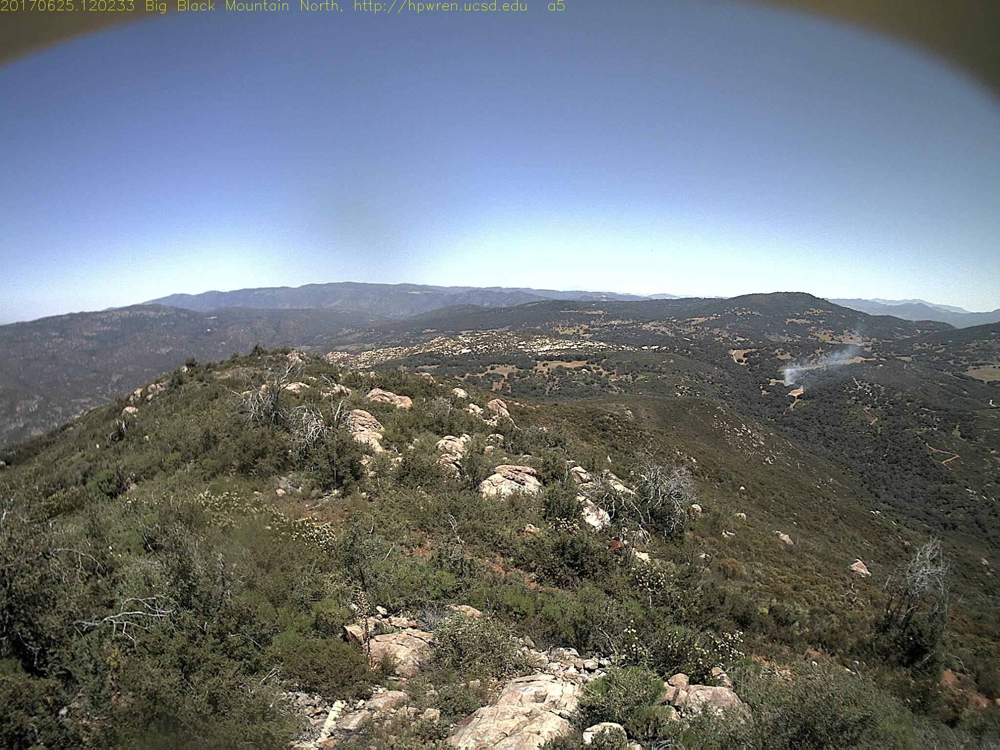

Smoke prediction for day Image:  No Smoke/Fire


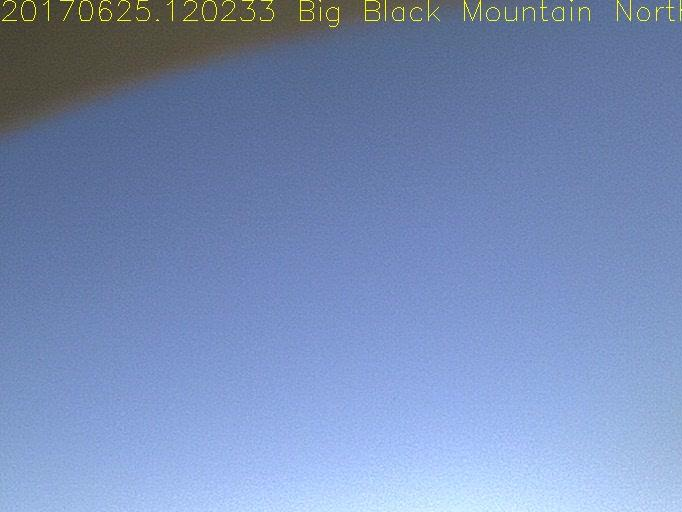

Smoke prediction for day Image:  No Smoke/Fire


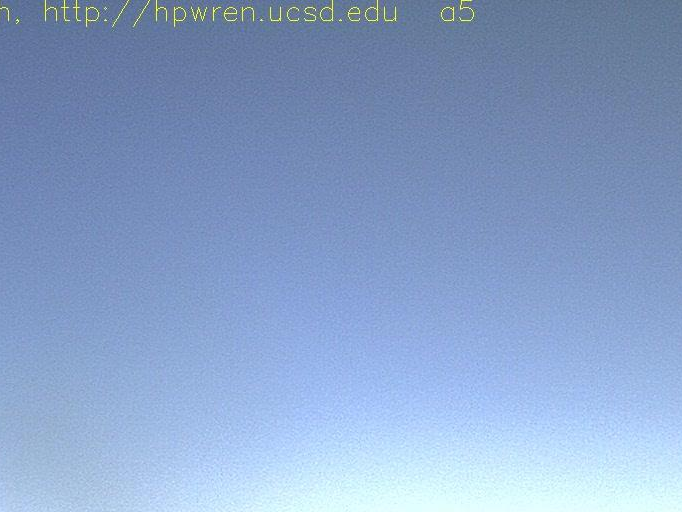

Smoke prediction for day Image:  No Smoke/Fire


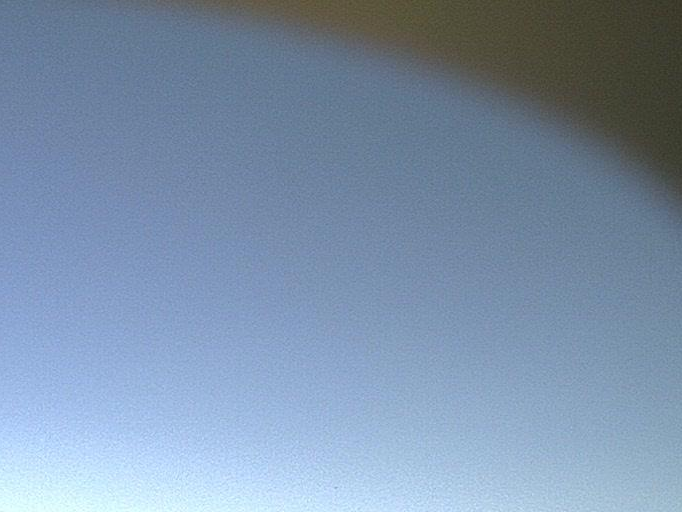

Fire prediction for Night Image :  No Forest Fire


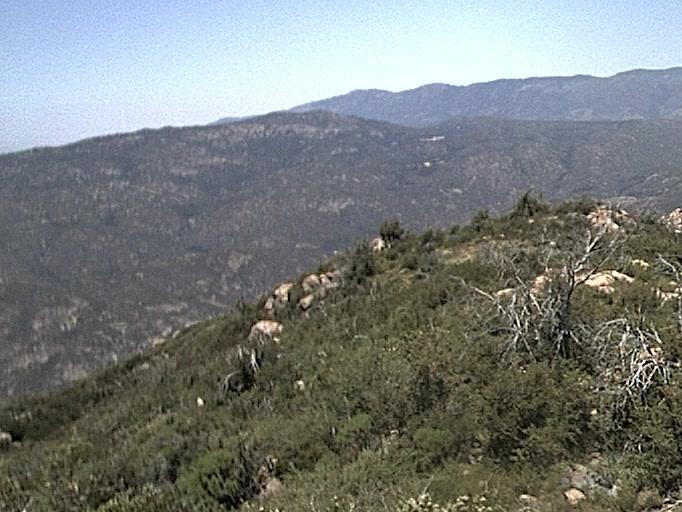

Smoke prediction for day Image:  No Smoke/Fire


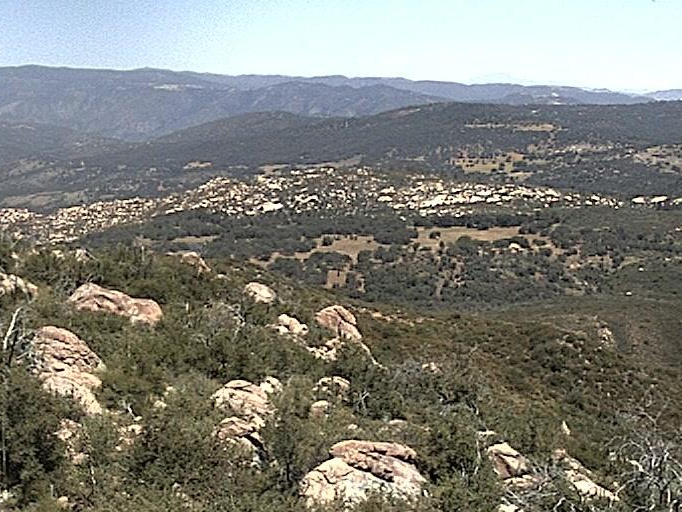

Smoke prediction for day Image:  No Smoke/Fire


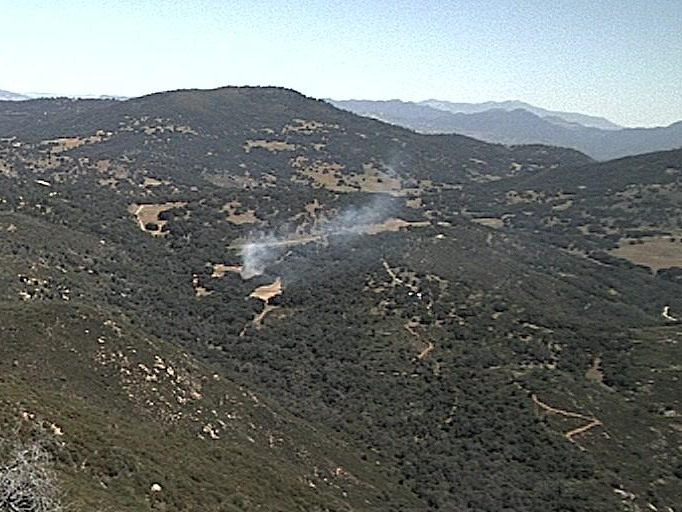

Smoke prediction for day Image:  Smoke/Fire


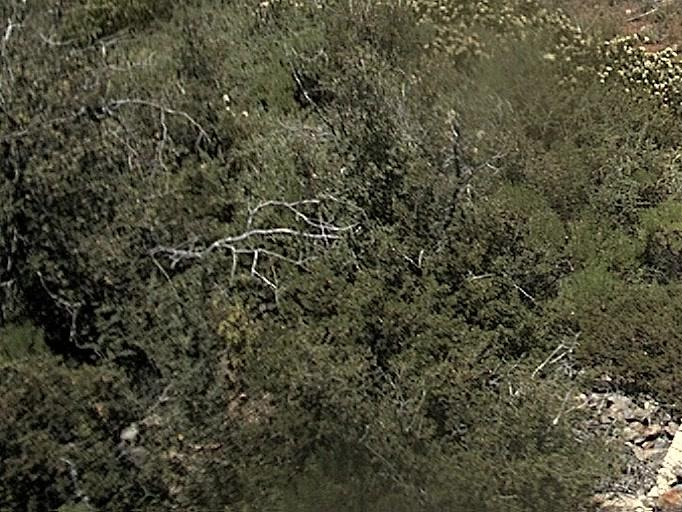

Smoke prediction for day Image:  No Smoke/Fire


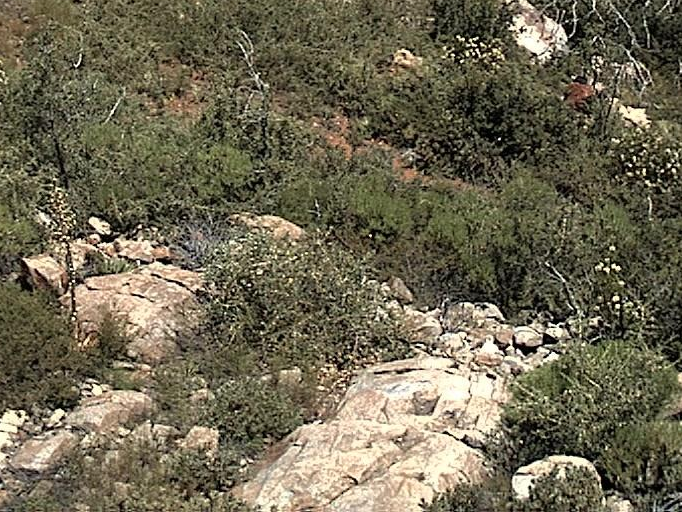

Smoke prediction for day Image:  No Smoke/Fire


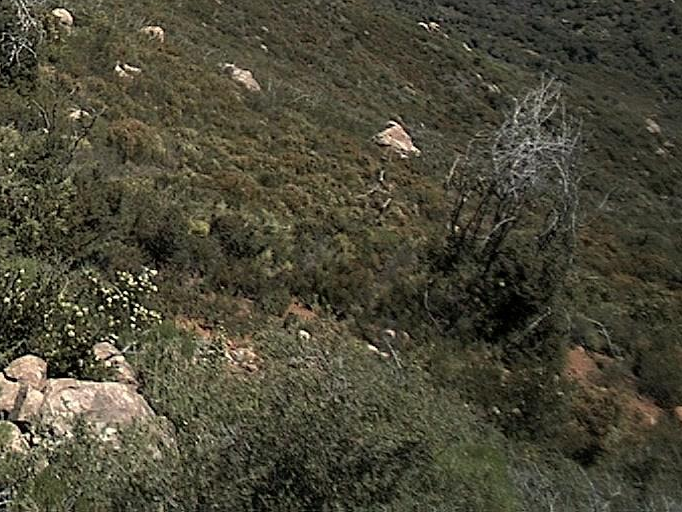

Smoke prediction for day Image:  No Smoke/Fire


In [153]:
#smoke 
subimages = divide_image(smoke[7])
image = smoke[7]
print("Original Image: ")
display(image)
night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
if(night_prediction == "Day"):
        Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        print("Smoke prediction for day Image: " , Smoke_prediction)
else:
        Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        print("Fire prediction for Night Image : " , Fireprediction)

for image in subimages:
        display(image)
        night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
        if(night_prediction == "Day"):
                Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
                print("Smoke prediction for day Image: " , Smoke_prediction)
        else:
                Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
                print("Fire prediction for Night Image : " , Fireprediction)
        
                


Original Image: 


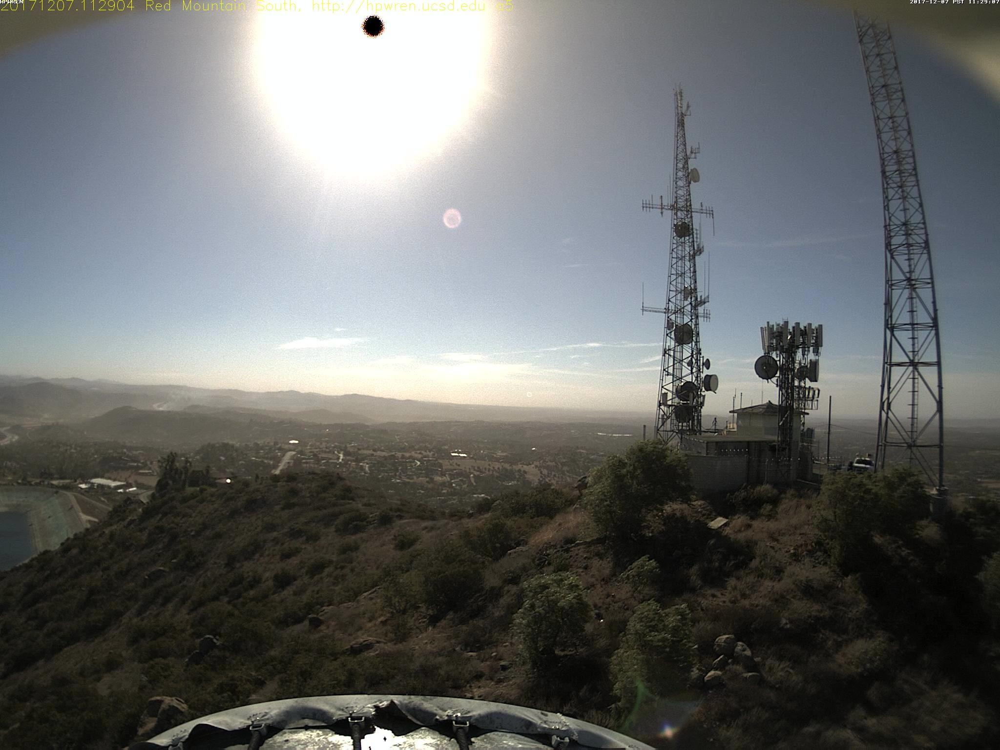

Smoke prediction for day Image:  No Forest Smoke/Fire


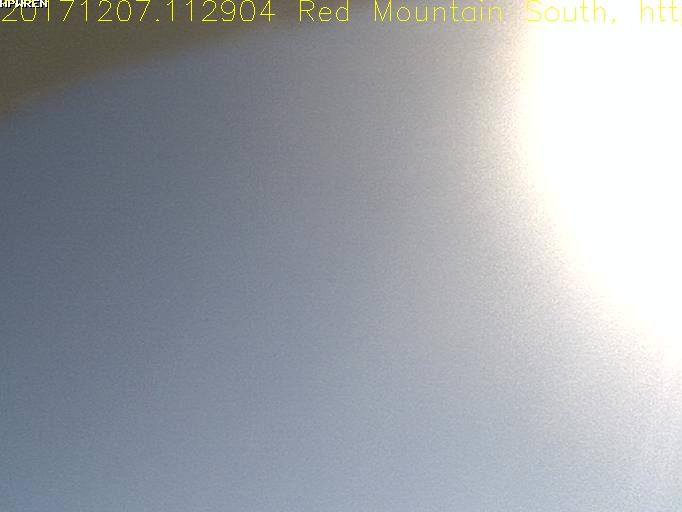

Smoke prediction for day Image:  No Forest Smoke/Fire


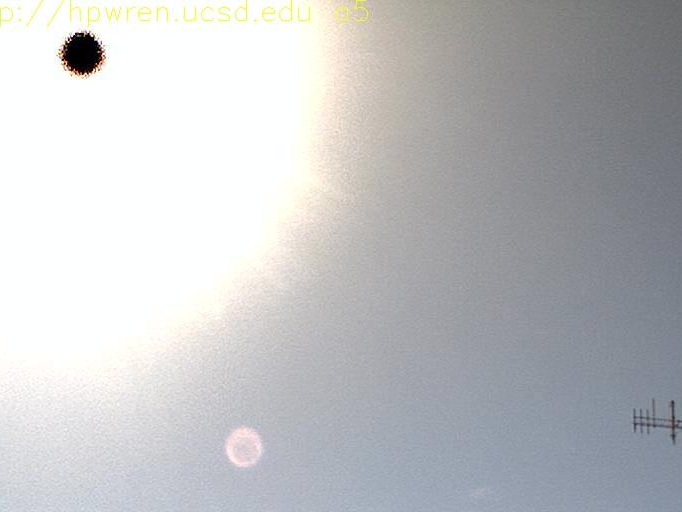

Smoke prediction for day Image:  No Forest Smoke/Fire


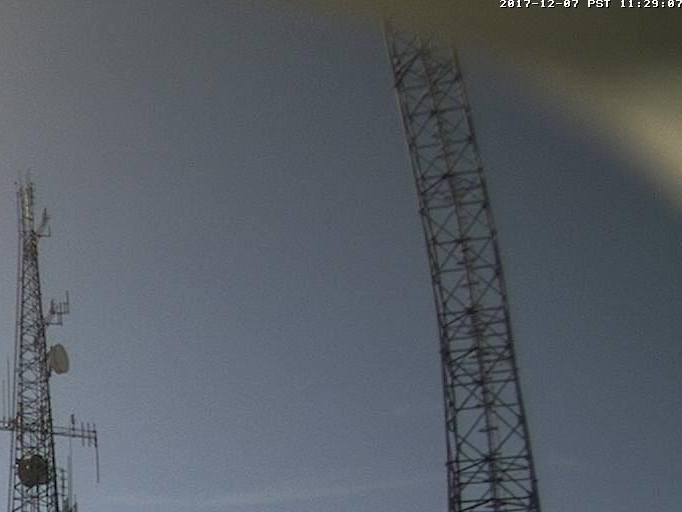

Smoke prediction for day Image:  No Forest Smoke/Fire


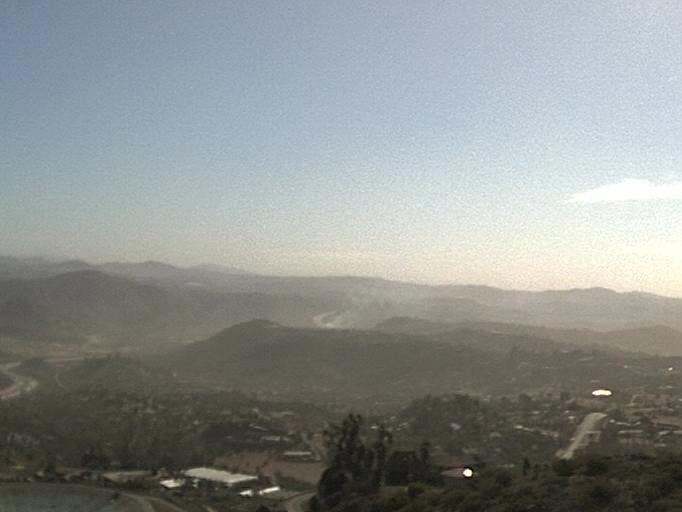

Smoke prediction for day Image:  No Forest Smoke/Fire


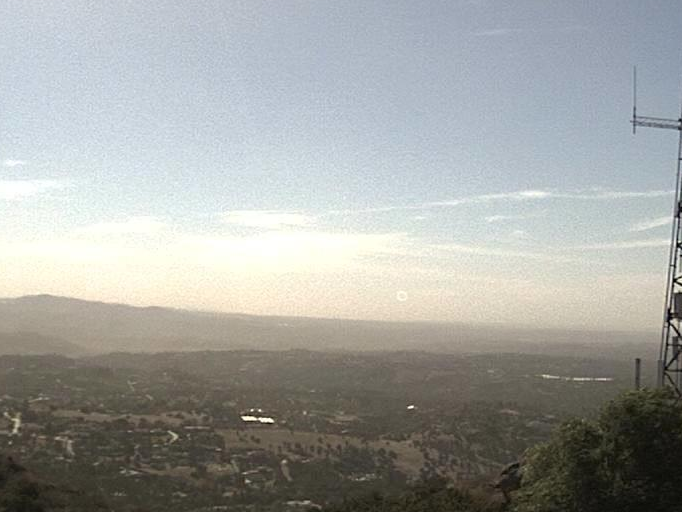

Smoke prediction for day Image:  No Forest Smoke/Fire


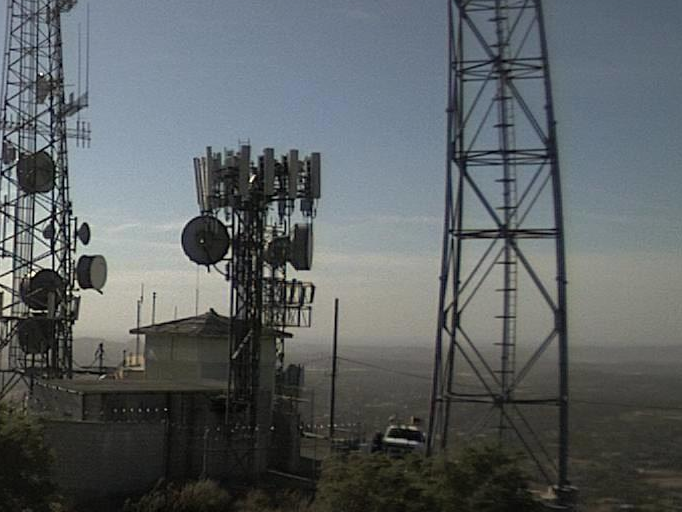

Smoke prediction for day Image:  No Forest Smoke/Fire


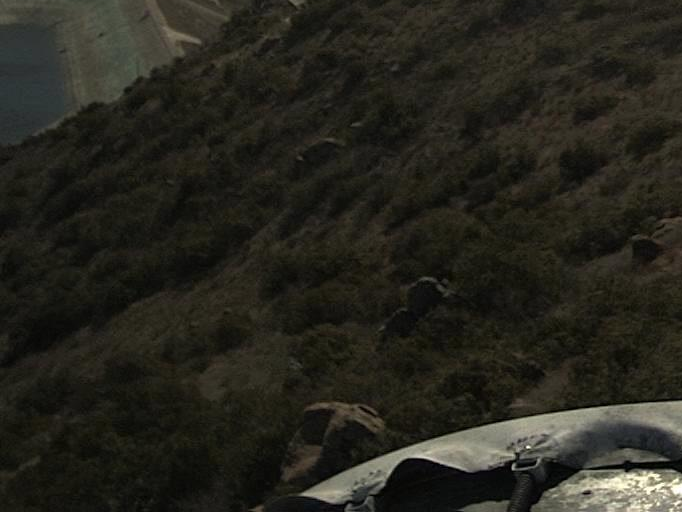

Smoke prediction for day Image:  No Forest Smoke/Fire


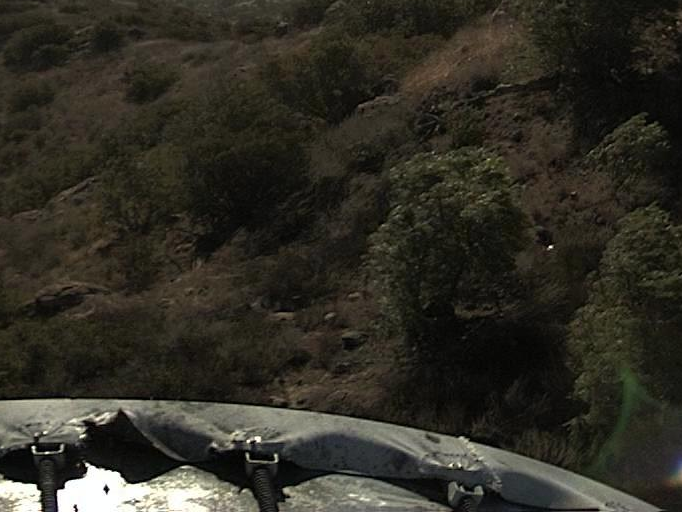

Smoke prediction for day Image:  No Forest Smoke/Fire


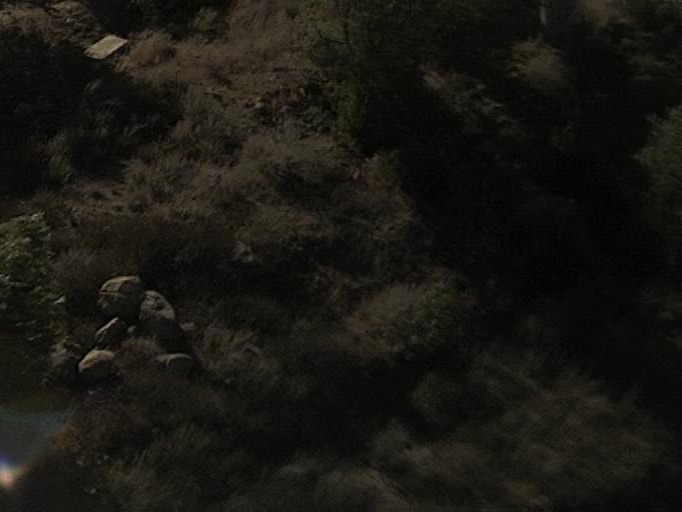

Smoke prediction for day Image:  No Forest Smoke/Fire


In [125]:
#empty
subimages = divide_image(empty[20])
image = empty[20]
print("Original Image: ")
display(image)
night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
if(night_prediction == "Day"):
        Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
        print("Smoke prediction for day Image: " , Smoke_prediction)
else:
        Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
        print("Fire prediction for Night Image : " , Fireprediction)

for image in subimages:
        display(image)
        night_prediction = detector(image, candidate_labels=["Day"  ,"Night"])[0]['label']
        if(night_prediction == "Day"):
                Smoke_prediction = detector(image, candidate_labels=["Smoke/Fire"  ,"No Smoke/Fire"])[0]['label']
                print("Smoke prediction for day Image: " , Smoke_prediction)
        else:
                Fireprediction = detector(image, candidate_labels=["Forest Fire"  ,"No Forest Fire"])[0]['label']
                print("Fire prediction for Night Image : " , Fireprediction)
        
                

**Results:**

Day/Night Layer : 

As the model accuracy for differentating between day and night is 100% we should add a day/night differentiator layer to the model becuase during night time the prompt Smoke/Fire gives very high false positive to avoide this we should add a layer for differentiating day and night.

Splitting Images :

* We Splitted each image into 9 subsections 

* The results were promising as not only the were the lower smaller images   being identified correctly but in some cases where the smoke in the original image was very small was detected in the sub images instead of the initial images
    
* In addition to the increased accuracy these subimages also gives us the location of the fire/smoke and can be used to make bounding boxes

**Future Direction**

Since the model is very good at identifying fire and smoke but for day time the accuracy of smoke detection is low because the smoke in the california dataset is very far away which is evident from the smoke sub images example . Similarly during night the model sometimes confuses Bright objects for Fire.

Finetuning the model on our custom dataset will highly improve the results. Secondly the model should be only testest on our own dataset not california dataset because although the terrain is similar but the california forest camera cover roughly 10 times more area then our PTZ cameras leading to a very small image of fire or Smoke 